<a href="https://colab.research.google.com/github/SistataRijal/wholesale-customer-product-purchase-prediction-with-ML/blob/main/Wholesale-Customers.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Analysis of ML Algorithms for Prediction of Customer's Product Purchase Behaviour**  
#Introduction  
### This notebook is based on the data from UCI ML Repository.The url to wholesale customers dataset is https://archive.ics.uci.edu/dataset/292/wholesale+customers .This dataset consists of 440 instances and 8 attributes. In this notebook, different ML algorithms have been applied to get the precise information on the customer's product purchasing behaviour.  
#About the dataset
###The dataset consists of customers annual spending on the products.
###Features:
* Channel ( 1 = Horeca (hotel, restuarent, cafe), 2 = Retail  )
* Region ( 1 = Lisbon , 2 = Oporto , 3 = Other regions )
* Fresh
* Milk
* Grocery
* Frozen
* Detergents_Paper
* Delicassen  
#Objectives :          
1. To observe the maximum and minimum sold products to the given channels.
2. To analyse which channel from which region has bought more products.
3. To examine which classification model works best with this dataset.

In [2]:
!pip3 install -U ucimlrepo

In [3]:
#importing libraries
import pandas as pd # to load/manipulate data
import numpy as np # to do mathematical calculations
import matplotlib.pyplot as plt # to plot in graph
%matplotlib inline
import seaborn as sns # for statics

#importing classifier Libraries
from sklearn.tree import DecisionTreeClassifier, plot_tree # to apply decision tree algorithm
from sklearn.ensemble import RandomForestClassifier # to apply random forest algorithm
from sklearn.naive_bayes import GaussianNB # to apply naive bayes algorithm
from sklearn import svm # to apply SVM(Support Vector Machine) algorithm
from sklearn.neighbors import KNeighborsClassifier # to apply KNN (K-Nearest Neighbour) algorithm
from sklearn.linear_model import LogisticRegression # to apply logistic regresion algorithm
from sklearn.model_selection import train_test_split # to split data into traing and testing sets
from sklearn.metrics import accuracy_score # to get the accuracy score

# importing other libraries
from sklearn.model_selection import train_test_split # to split data into testing and training sets
from ucimlrepo import fetch_ucirepo # to fetch data from uci repository

In [28]:
from google.colab import drive
drive.mount('/content/drive')

df = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/Wholesale customers data.csv') # to read the data file

# to load the dataset
customers = fetch_ucirepo(id=292)
X = customers.data.features
y = customers.data.targets

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


#Exploraory Data Analysis

In [5]:
df.head()

,Channel,Region,Fresh,Milk,Grocery,Frozen,Detergents_Paper,Delicassen
0,2,3,12669,9656,7561,214,2674,1338
1,2,3,7057,9810,9568,1762,3293,1776
2,2,3,6353,8808,7684,2405,3516,7844
3,1,3,13265,1196,4221,6404,507,1788
4,2,3,22615,5410,7198,3915,1777,5185


In [6]:
df.tail()

,Channel,Region,Fresh,Milk,Grocery,Frozen,Detergents_Paper,Delicassen
435,1,3,29703,12051,16027,13135,182,2204
436,1,3,39228,1431,764,4510,93,2346
437,2,3,14531,15488,30243,437,14841,1867
438,1,3,10290,1981,2232,1038,168,2125
439,1,3,2787,1698,2510,65,477,52


In [26]:
df.describe()

,Channel,Region,Fresh,Milk,Grocery,Frozen,Detergents_Paper,Delicassen
count,440.000000,440.000000,440.000000,440.000000,440.000000,440.000000,440.000000,440.000000
mean,1.322727,2.543182,12000.297727,5796.265909,7951.277273,3071.931818,2881.493182,1524.870455
std,0.468052,0.774272,12647.328865,7380.377175,9503.162829,4854.673333,4767.854448,2820.105937
min,1.000000,1.000000,3.000000,55.000000,3.000000,25.000000,3.000000,3.000000
25%,1.000000,2.000000,3127.750000,1533.000000,2153.000000,742.250000,256.750000,408.250000
50%,1.000000,3.000000,8504.000000,3627.000000,4755.500000,1526.000000,816.500000,965.500000
75%,2.000000,3.000000,16933.750000,7190.250000,10655.750000,3554.250000,3922.000000,1820.250000
max,2.000000,3.000000,112151.000000,73498.000000,92780.000000,60869.000000,40827.000000,47943.000000


In [8]:
df.shape

(440, 8)

In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 440 entries, 0 to 439
Data columns (total 8 columns):
 #   Column            Non-Null Count  Dtype
---  ------            --------------  -----
 0   Channel           440 non-null    int64
 1   Region            440 non-null    int64
 2   Fresh             440 non-null    int64
 3   Milk              440 non-null    int64
 4   Grocery           440 non-null    int64
 5   Frozen            440 non-null    int64
 6   Detergents_Paper  440 non-null    int64
 7   Delicassen        440 non-null    int64
dtypes: int64(8)
memory usage: 27.6 KB


In [10]:
df.columns

Index(['Channel', 'Region', 'Fresh', 'Milk', 'Grocery', 'Frozen',
       'Detergents_Paper', 'Delicassen'],
      dtype='object')

In [11]:
#Checking null values
print(df.isnull().values.sum())

# To replace null values with nan
df = df.replace(" ",np.nan)

# to print the tota no. of null values
print(df.isnull().values.sum())

0
0


##From all the above informations, it can be seen that :
* There are no missing values so no preprocessing is required.
* Memory usage is 27.6 KB .
* Dtatype for all column is int64.

<Axes: xlabel='Region', ylabel='Count'>

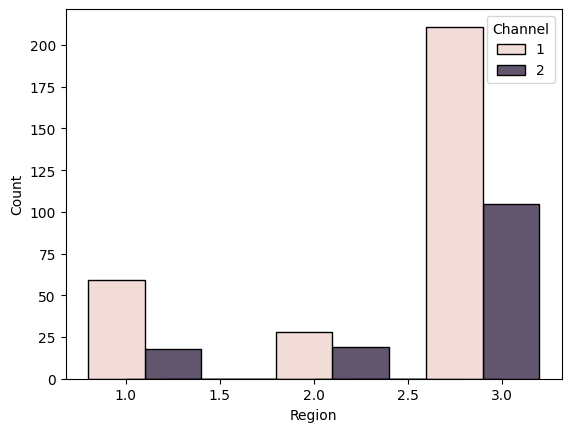

In [12]:
# Creating bar graph using histplot

sns.histplot(data=df, x="Region", hue="Channel", multiple = "dodge", shrink=3)

###From the above bar-graph, it can be seen that:
* Products are bought by Channel 1(Horeca) and channel 2(Retail) from region 3 (other regions) the most means region 3 has sold more products.
* It can also be seen that Region 2 (Oporto) has the least no. of Channels so it also has sold the least no. of products.

<Axes: xlabel='Channel', ylabel='Fresh'>

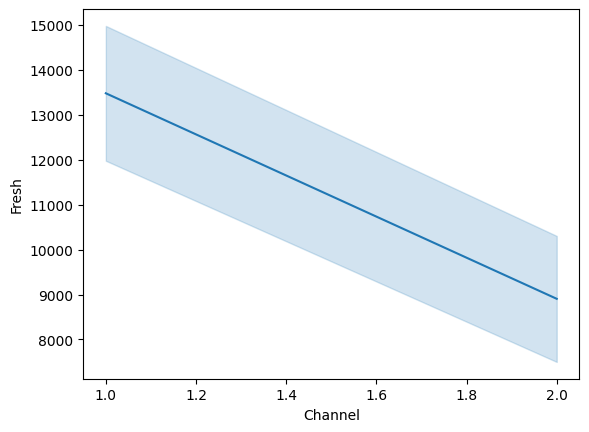

In [13]:
#creating line graph

sns.lineplot(data=df, x="Channel", y="Fresh")

<Axes: xlabel='Channel', ylabel='Milk'>

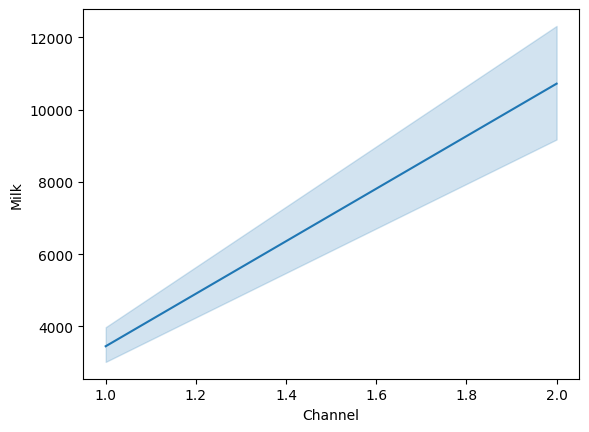

In [14]:
sns.lineplot(data=df, x="Channel", y="Milk")

<Axes: xlabel='Channel', ylabel='Grocery'>

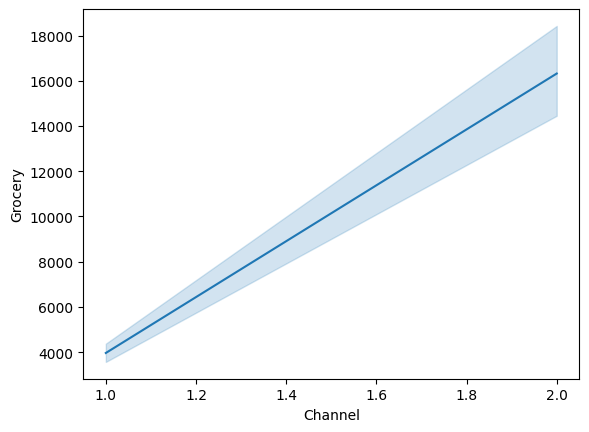

In [15]:
sns.lineplot(data=df, x="Channel", y="Grocery")

<Axes: xlabel='Channel', ylabel='Frozen'>

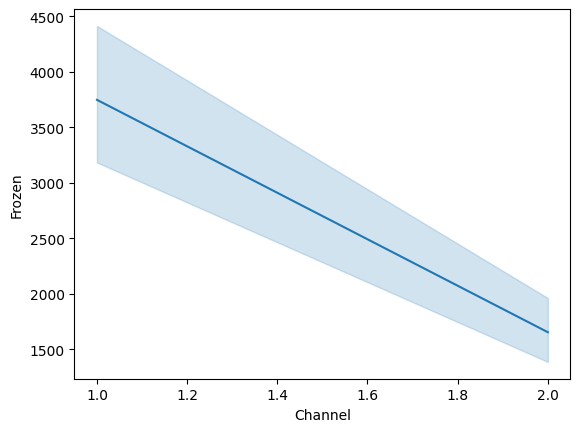

In [16]:
sns.lineplot(data=df, x="Channel", y="Frozen")

<Axes: xlabel='Channel', ylabel='Detergents_Paper'>

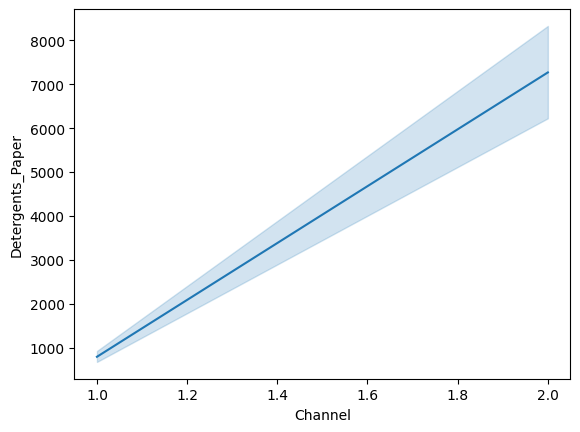

In [17]:
sns.lineplot(data=df, x="Channel", y="Detergents_Paper")

<Axes: xlabel='Channel', ylabel='Delicassen'>

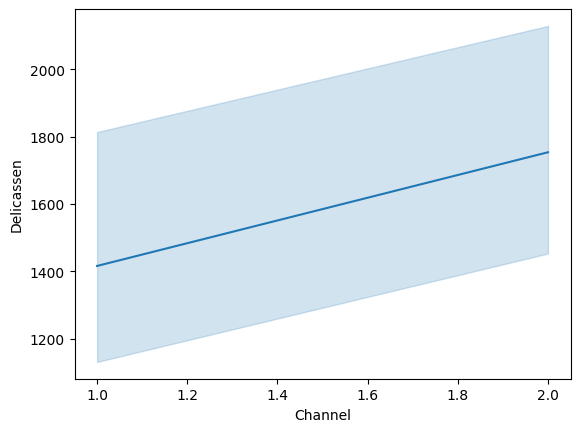

In [18]:
sns.lineplot(data=df, x="Channel", y="Delicassen")

###From the above line graphs,  it is clear that Channel 2 has bought expensive and more products than Channel 1.

#Model Performance  
###Now, we will be and comparing all the models at last to see which classifier is the best to use in this dataset.

#Decision Tree Classifier

The accuracy :  0.6136363636363636


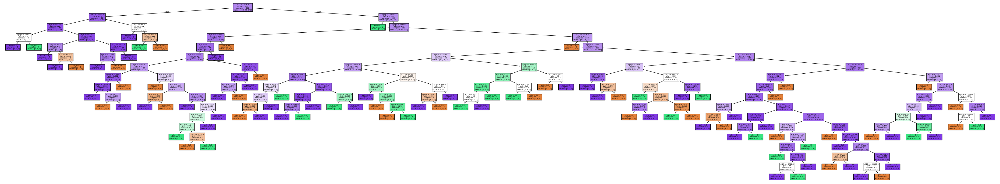

In [19]:
# to split the data into test and train
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

#to create decision tree
dt_classifier = DecisionTreeClassifier(random_state=42, criterion="gini")

# for training the model
dt_classifier.fit(X_train, y_train)

# to make predictions on test datasets
predict = dt_classifier.predict(X_test)

# to calculate the accuracy score
accuracy = accuracy_score(y_test, predict)
print("The accuracy : ", accuracy)

# to plot in the decision tree
plt.figure(figsize = (55,10))
plot_tree(dt_classifier, feature_names =customers.target_names, filled =True )
plt.show()

##Accuracy Rate from Decision Tree Ckassifier is 0.613 i.e. 61.3%.

#Random Forest

In [27]:
# to create random forest classifier using 50 trees (default tree no. is 100)
rf_classifier = RandomForestClassifier(n_estimators=50, random_state=42)

#to train the model
rf_classifier.fit(X_train, y_train)

#to predict on the test set
predict = rf_classifier.predict(X_test)

#to calculate accuracy score
accuracy = accuracy_score(y_test, predict)
print("Accuracy:", accuracy)

#to plot decision trees in random forext
n_estimators = len(rf_classifier.estimators_)
n_cols=5
n_rows = (n_estimators // n_cols) + (n_estimators % n_cols > 0)
plt.figure(figsize=(200, 180)) # to make 30 by 10 figure size

for i, estimator in enumerate(rf_classifier.estimators_): # to make interactive graph
  plt.subplot(n_rows, n_cols, i + 1)
  plot_tree(estimator, feature_names=customers.feature_names,  class_names=customers.target_names,  filled=True)
plt.tight_layout()
plt.show()

/usr/local/lib/python3.11/dist-packages/sklearn/base.py:1389: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


Accuracy: 0.8522727272727273


##The Accuracy rate from random forest classifier is 85%.

#KNN(K-Nearest Neighbour) Classifier

In [21]:
# To create a KNN classifier
knn_classifier = KNeighborsClassifier(n_neighbors=10)

#To train the model
knn_classifier.fit(X_train, y_train)

#To prodict on text set
predict = knn_classifier.predict(X_test)

#To calculate accuracy score
accuracy = accuracy_score(y_test, predict)
print(" Accuгасу : ", accuracy)

 Accuгасу :  0.8409090909090909


/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_classification.py:239: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


##Accuracy rate from KNN Classifier is 0.84 it 84%.

#Naive Bayes

In [23]:
#To create a Gaussian Naive Bayes classifier
GaussianNB = GaussianNB()

#to train the model
GaussianNB.fit(X_train, y_train)

#to predict on test set
predict = GaussianNB.predict(X_test)

#Calculate accuracy score
accuracy = accuracy_score(y_test, predict)
print("Naive Bayes Accuracy:", accuracy)

Naive Bayes Accuracy: 0.3409090909090909


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1408: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


## The Accuracy Rate from Naive Bayes Classifier is 0.34 i.e. 34%.

#SVM(Support Vector Machine)

In [22]:
#to create an SVM classifier
svm= svm.SVC(kernel='linear') # using linear kernel

#to train the model
svm.fit(X_train, y_train)

#to predict on test set
predict = svm.predict(X_test)

#to calculate accuracy score
accuracy = accuracy_score(y_test, predict)
print('ccuracy : ', accuracy)

/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:1408: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


ccuracy :  0.7840909090909091


##The Accuracy Rate from SVM Classifier is 0.784 i.e. 78.4%.

#Comapring the Models

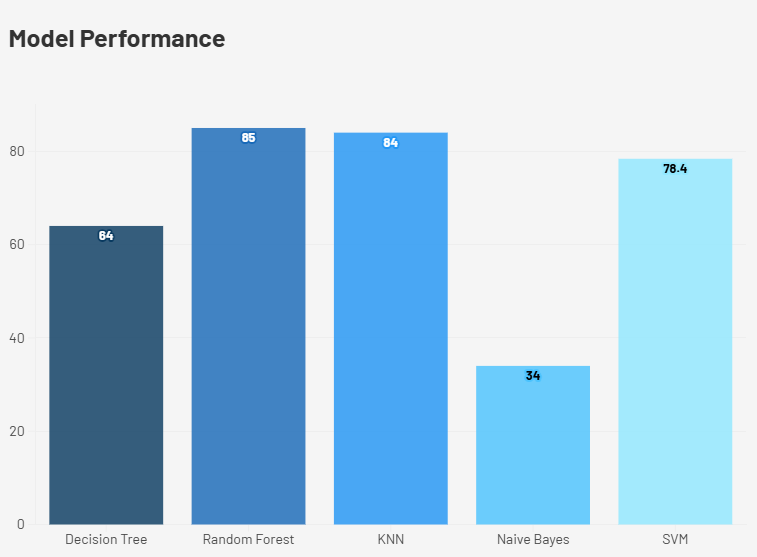

# **Findings :**
##F1: The Random Forest Classifier Works best in this dataset where as Naive Bayes Classifier's performance was the least applicable.  
##F2: Channel 2 (retail) from region 3 (other regions) has bought more products where as least amount of products is sold to channel 1 from region 1. In conclusion, channel two has bought more products in all over.
##F3: Fresh products were bought the most where as  where bought the least.